In [13]:
import h5py
import torch
from torch import nn
from torch.utils.data import Dataset, DataLoader
from torch import optim
from torch.optim import AdamW
from tqdm import tqdm
import torchvision
from torchvision.transforms import ToTensor, ToPILImage
from torchvision.utils import save_image
from PIL import Image
import numpy as np
from sklearn.model_selection import train_test_split
from torchvision import transforms
from torch.nn import functional as F

from itertools import product

import os
import shutil
from tqdm import tqdm
from concurrent.futures import ThreadPoolExecutor, as_completed
from torchvision.utils import make_grid
import pandas as pd
import matplotlib.pyplot as plt

In [ ]:
class RainDataset(Dataset):
    def __init__(self, input_paths, target_paths):
        super().__init__()
        self.input_paths = input_paths
        self.target_paths = target_paths
        self.transform = transforms.Compose([
            # transforms.Resize((256, 256)),
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5]) 
        ])
        
    def __len__(self):
        return len(self.input_paths)
    
    def __getitem__(self, idx):
        input_image = Image.open(self.input_paths[idx]).convert("RGB")
        target_image = Image.open(self.target_paths[idx]).convert("RGB")
        
        input_image = self.transform(input_image)
        target_image = self.transform(target_image)
        return input_image, target_image

In [15]:
class GeneratorLoss(nn.Module):
    def __init__(self, alpha=100):
        super().__init__()
        self.alpha=alpha
        self.bce=nn.BCEWithLogitsLoss()
        self.l1=nn.L1Loss()
        
    def forward(self, fake, real, fake_pred):
        fake_target = torch.ones_like(fake_pred)
        loss = self.bce(fake_pred, fake_target) + self.alpha* self.l1(fake, real)
        return loss
    
    
class DiscriminatorLoss(nn.Module):
    def __init__(self,):
        super().__init__()
        self.loss_fn = nn.BCEWithLogitsLoss()
        
    def forward(self, fake_pred, real_pred):
        fake_target = torch.zeros_like(fake_pred)
        real_target = torch.ones_like(real_pred)
        fake_loss = self.loss_fn(fake_pred, fake_target)
        real_loss = self.loss_fn(real_pred, real_target)
        loss = (fake_loss + real_loss)/2
        return loss

In [16]:
import torch
from torch import nn
import torchvision.models as models


class PerceptualLoss(nn.Module):
    """VGG-based Perceptual Loss"""
    def __init__(self):
        super().__init__()
        # Load pretrained VGG16
        vgg = models.vgg16(pretrained=True).features
        
        # Extract features from relu3_3 (layer 15)
        self.feature_extractor = nn.Sequential(*list(vgg.children())[:16]).eval()
        
        # Freeze VGG parameters
        for param in self.feature_extractor.parameters():
            param.requires_grad = False
        
        self.loss_fn = nn.L1Loss()
        
    def forward(self, fake, real):
        """
        fake, real: [B, 3, H, W] in range [0, 1]
        """
        # Normalize images (ImageNet normalization)
        mean = torch.tensor([0.485, 0.456, 0.406]).view(1, 3, 1, 1).to(fake.device)
        std = torch.tensor([0.229, 0.224, 0.225]).view(1, 3, 1, 1).to(fake.device)
        
        fake_norm = (fake - mean) / std
        real_norm = (real - mean) / std
        
        # Extract features
        fake_features = self.feature_extractor(fake_norm)
        real_features = self.feature_extractor(real_norm)
        
        # Compute L1 loss between features
        return self.loss_fn(fake_features, real_features)


class ImprovedGeneratorLoss(nn.Module):
    """
    Generator Loss = GAN Loss + alpha * L1 Loss + beta * Perceptual Loss
    """
    def __init__(self, alpha=100, beta=10):
        super().__init__()
        self.alpha = alpha
        self.beta = beta
        
        self.bce = nn.BCEWithLogitsLoss()
        self.l1 = nn.L1Loss()
        self.perceptual = PerceptualLoss()
        
    def forward(self, fake, real, fake_pred):
        """
        fake, real: Generator output và ground truth ([-1, 1] range)
        fake_pred: Discriminator prediction for fake images
        """
        # 1. GAN Loss (Adversarial)
        fake_target = torch.ones_like(fake_pred)
        gan_loss = self.bce(fake_pred, fake_target)
        
        # 2. L1 Loss (Pixel-level)
        l1_loss = self.l1(fake, real)
        
        # 3. Perceptual Loss (Feature-level)
        # Denormalize to [0, 1] for VGG
        fake_denorm = (fake + 1) / 2
        real_denorm = (real + 1) / 2
        perceptual_loss = self.perceptual(fake_denorm, real_denorm)
        
        # Total loss
        total_loss = gan_loss + self.alpha * l1_loss + self.beta * perceptual_loss
        
        return total_loss

In [17]:
class BasicBlock(nn.Module):
    """Basic block"""
    def __init__(self, inplanes, outplanes, kernel_size=4, stride=2, padding=1, norm=True):
        super().__init__()
        self.conv = nn.Conv2d(inplanes, outplanes, kernel_size, stride, padding)
        self.isn = None
        if norm:
            self.isn = nn.InstanceNorm2d(outplanes)
        self.lrelu = nn.LeakyReLU(0.2, inplace=True)
        
    def forward(self, x):
        fx = self.conv(x)
        
        if self.isn is not None:
            fx = self.isn(fx)
            
        fx = self.lrelu(fx)
        return fx
    
    
class Discriminator(nn.Module):
    """Basic Discriminator"""
    def __init__(self,):
        super().__init__()
        self.block1 = BasicBlock(3, 64, norm=False)
        self.block2 = BasicBlock(64, 128)
        self.block3 = BasicBlock(128, 256)
        self.block4 = BasicBlock(256, 512)
        self.block5 = nn.Conv2d(512, 1, kernel_size=4, stride=1, padding=1)
        
    def forward(self, x):
        fx = self.block1(x)
        fx = self.block2(fx)
        fx = self.block3(fx)
        fx = self.block4(fx)
        fx = self.block5(fx)
        
        return fx
    
    
class ConditionalDiscriminator(nn.Module):
    """Conditional Discriminator"""
    def __init__(self,):
        super().__init__()
        self.block1 = BasicBlock(6, 64, norm=False)
        self.block2 = BasicBlock(64, 128)
        self.block3 = BasicBlock(128, 256)
        self.block4 = BasicBlock(256, 512)
        self.block5 = nn.Conv2d(512, 1, kernel_size=4, stride=1, padding=1)
        
    def forward(self, x, cond):
        x = torch.cat([x, cond], dim=1)

        fx = self.block1(x)
        fx = self.block2(fx)
        fx = self.block3(fx)
        fx = self.block4(fx)
        fx = self.block5(fx)
        
        return fx

In [18]:
class EncoderBlock(nn.Module):
    """Encoder block"""
    def __init__(self, inplanes, outplanes, kernel_size=4, stride=2, padding=1, norm=True):
        super().__init__()
        self.lrelu = nn.LeakyReLU(0.2, inplace=True)
        self.conv = nn.Conv2d(inplanes, outplanes, kernel_size, stride, padding)
        
        self.bn=None
        if norm:
            self.bn = nn.BatchNorm2d(outplanes)
        
    def forward(self, x):
        fx = self.lrelu(x)
        fx = self.conv(fx)
        
        if self.bn is not None:
            fx = self.bn(fx)
            
        return fx

    
class DecoderBlock(nn.Module):
    """Decoder block"""
    def __init__(self, inplanes, outplanes, kernel_size=4, stride=2, padding=1, dropout=False):
        super().__init__()
        self.relu = nn.ReLU(inplace=True)
        self.deconv = nn.ConvTranspose2d(inplanes, outplanes, kernel_size, stride, padding)
        self.bn = nn.BatchNorm2d(outplanes)       
        
        self.dropout=None
        if dropout:
            self.dropout = nn.Dropout2d(p=0.5, inplace=True)
            
    def forward(self, x):
        fx = self.relu(x)
        fx = self.deconv(fx)
        fx = self.bn(fx)

        if self.dropout is not None:
            fx = self.dropout(fx)
            
        return fx

    
class Generator(nn.Module):
    """Encoder-Decoder model"""
    def __init__(self,):
        super().__init__()
        
        self.encoder1 = nn.Conv2d(3, 64, kernel_size=4, stride=2, padding=1)
        self.encoder2 = EncoderBlock(64, 128)
        self.encoder3 = EncoderBlock(128, 256)
        self.encoder4 = EncoderBlock(256, 512)
        self.encoder5 = EncoderBlock(512, 512)
        self.encoder6 = EncoderBlock(512, 512)
        self.encoder7 = EncoderBlock(512, 512)
        self.encoder8 = EncoderBlock(512, 512, norm=False)
        
        self.decoder8 = DecoderBlock(512, 512, dropout=True)
        self.decoder7 = DecoderBlock(512, 512, dropout=True)
        self.decoder6 = DecoderBlock(512, 512, dropout=True)
        self.decoder5 = DecoderBlock(512, 512)
        self.decoder4 = DecoderBlock(512, 256)
        self.decoder3 = DecoderBlock(256, 128)
        self.decoder2 = DecoderBlock(128, 64)
        self.decoder1 = nn.ConvTranspose2d(64, 3, kernel_size=4, stride=2, padding=1)
        
    def forward(self, x):
        e1 = self.encoder1(x)
        e2 = self.encoder2(e1)
        e3 = self.encoder3(e2)
        e4 = self.encoder4(e3)
        e5 = self.encoder5(e4)
        e6 = self.encoder6(e5)
        e7 = self.encoder7(e6)
        e8 = self.encoder8(e7)

        d8 = self.decoder8(e8)
        d7 = self.decoder7(d8)
        d6 = self.decoder6(d7)
        d5 = self.decoder5(d6)
        d4 = self.decoder4(d5)
        d3 = self.decoder3(d4)
        d2 = F.relu(self.decoder2(d3))
        d1 = self.decoder1(d2)
        
        return torch.tanh(d1)
    
    
class UnetGenerator(nn.Module):
    """Unet-like Encoder-Decoder model"""
    def __init__(self,):
        super().__init__()
        
        self.encoder1 = nn.Conv2d(3, 64, kernel_size=4, stride=2, padding=1)
        self.encoder2 = EncoderBlock(64, 128)
        self.encoder3 = EncoderBlock(128, 256)
        self.encoder4 = EncoderBlock(256, 512)
        self.encoder5 = EncoderBlock(512, 512)
        self.encoder6 = EncoderBlock(512, 512)
        self.encoder7 = EncoderBlock(512, 512)
        self.encoder8 = EncoderBlock(512, 512, norm=False)
        
        self.decoder8 = DecoderBlock(512, 512, dropout=True)
        self.decoder7 = DecoderBlock(2*512, 512, dropout=True)
        self.decoder6 = DecoderBlock(2*512, 512, dropout=True)
        self.decoder5 = DecoderBlock(2*512, 512)
        self.decoder4 = DecoderBlock(2*512, 256)
        self.decoder3 = DecoderBlock(2*256, 128)
        self.decoder2 = DecoderBlock(2*128, 64)
        self.decoder1 = nn.ConvTranspose2d(2*64, 3, kernel_size=4, stride=2, padding=1)
        
    def forward(self, x):
        e1 = self.encoder1(x)
        e2 = self.encoder2(e1)
        e3 = self.encoder3(e2)
        e4 = self.encoder4(e3)
        e5 = self.encoder5(e4)
        e6 = self.encoder6(e5)
        e7 = self.encoder7(e6)
        e8 = self.encoder8(e7)

        d8 = self.decoder8(e8)
        d8 = torch.cat([d8, e7], dim=1)
        d7 = self.decoder7(d8)
        d7 = torch.cat([d7, e6], dim=1)
        d6 = self.decoder6(d7)
        d6 = torch.cat([d6, e5], dim=1)
        d5 = self.decoder5(d6)
        d5 = torch.cat([d5, e4], dim=1)
        d4 = self.decoder4(d5)
        d4 = torch.cat([d4, e3], dim=1)
        d3 = self.decoder3(d4)
        d3 = torch.cat([d3, e2], dim=1)
        d2 = F.relu(self.decoder2(d3))
        d2 = torch.cat([d2, e1], dim=1)
        d1 = self.decoder1(d2)
        
        return torch.tanh(d1)

In [ ]:
def psnr(x, y, data_range=1.0):
    mse = torch.mean((x - y) ** 2)
    if mse == 0:
        return float('inf')
    return 20 * torch.log10(data_range / torch.sqrt(mse))


def ssim(x, y, kernel_size=11, kernel_sigma=1.5, data_range=1.0, k1=0.01, k2=0.03):
    coords = torch.arange(kernel_size, dtype=x.dtype, device=x.device)
    coords -= (kernel_size - 1) / 2.0
    g = coords ** 2
    g = (- (g.unsqueeze(0) + g.unsqueeze(1)) / (2 * kernel_sigma ** 2)).exp()
    g /= g.sum()
    kernel = g.unsqueeze(0).repeat(x.size(1), 1, 1, 1)

    c1, c2 = (k1 * data_range) ** 2, (k2 * data_range) ** 2
    n_channels = x.size(1)

    padding = kernel_size // 2 
    
    mu_x = F.conv2d(x, weight=kernel, stride=1, padding=padding, groups=n_channels)
    mu_y = F.conv2d(y, weight=kernel, stride=1, padding=padding, groups=n_channels)

    mu_xx, mu_yy, mu_xy = mu_x ** 2, mu_y ** 2, mu_x * mu_y
    sigma_xx = F.conv2d(x ** 2, weight=kernel, stride=1, padding=padding, groups=n_channels) - mu_xx
    sigma_yy = F.conv2d(y ** 2, weight=kernel, stride=1, padding=padding, groups=n_channels) - mu_yy
    sigma_xy = F.conv2d(x * y, weight=kernel, stride=1, padding=padding, groups=n_channels) - mu_xy

    cs = (2.0 * sigma_xy + c2) / (sigma_xx + sigma_yy + c2)
    ss = (2.0 * mu_xy + c1) / (mu_xx + mu_yy + c1) * cs
    return ss.mean()

In [ ]:
def pad_to_multiple(img, multiple=256):
    """Pad ảnh để kích thước chia hết cho multiple"""
    _, _, h, w = img.shape
    pad_h = (multiple - h % multiple) % multiple
    pad_w = (multiple - w % multiple) % multiple
    
    img_padded = F.pad(img, (0, pad_w, 0, pad_h), mode='reflect')
    return img_padded, h, w


def evaluate_model_original_size(generator, dataloader, device):
    generator.eval()
    total_l1_loss = 0.0
    total_psnr = 0.0
    total_ssim = 0.0
    l1_loss_fn = torch.nn.L1Loss()
    count = 0
    
    with torch.no_grad():
        for inputs, targets in tqdm(dataloader, desc="Evaluating"):
            inputs, targets = inputs.to(device), targets.to(device)
            
            inputs_padded, original_h, original_w = pad_to_multiple(inputs)
            
            fake_images_padded = generator(inputs_padded)
            
            fake_images = fake_images_padded[:, :, :original_h, :original_w]
            inputs = inputs[:, :, :original_h, :original_w]
            targets = targets[:, :, :original_h, :original_w]
            
            fake_images = (fake_images + 1) / 2
            fake_images = torch.clamp(fake_images, 0, 1)
            targets = (targets + 1) / 2
            targets = torch.clamp(targets, 0, 1)
            
            total_l1_loss += l1_loss_fn(fake_images, targets).item()
            total_psnr += psnr(fake_images, targets)
            total_ssim += ssim(fake_images, targets)
            count += 1
    
    avg_l1_loss = total_l1_loss / count
    avg_psnr = total_psnr / count
    avg_ssim = total_ssim / count
    
    print(f"Avg L1 Loss: {avg_l1_loss:.4f}, Avg PSNR: {avg_psnr:.2f}, Avg SSIM: {avg_ssim:.4f}")
    return avg_l1_loss, avg_psnr, avg_ssim

In [ ]:
def save_sample_images(dataset_name, generator, dataloader, save_dir, device, max_samples=3):
    generator.eval()
    os.makedirs(save_dir, exist_ok=True)
    
    data_iter = iter(dataloader)
    samples_collected = 0
    
    inputs_list = []
    fakes_list = []
    targets_list = []
    sizes_list = []
    
    with torch.no_grad():
        while samples_collected < max_samples:
            try:
                inputs, targets = next(data_iter)
            except StopIteration:
                break
            
            inputs = inputs.to(device)
            targets = targets.to(device)
            
            inputs_padded, original_h, original_w = pad_to_multiple(inputs)
            
            fakes_padded = generator(inputs_padded)
            
            fakes = fakes_padded[:, :, :original_h, :original_w]
            inputs = inputs[:, :, :original_h, :original_w]
            targets = targets[:, :, :original_h, :original_w]
            
            inputs = torch.clamp((inputs + 1) / 2, 0, 1)
            targets = torch.clamp((targets + 1) / 2, 0, 1)
            fakes = torch.clamp((fakes + 1) / 2, 0, 1)
            
            inputs_list.append(inputs)  # Shape: [1, 3, H, W]
            fakes_list.append(fakes)
            targets_list.append(targets)
            sizes_list.append((original_h, original_w))
            
            samples_collected += 1
    
    if samples_collected == 0:
        print(f"⚠️ Không có ảnh nào để lưu cho {dataset_name}")
        return
    
    # LƯU FILE RAW (Từng ảnh riêng lẻ)
    raw_dir = os.path.join(save_dir, "raw")
    os.makedirs(raw_dir, exist_ok=True)
    
    for i in range(samples_collected):
        h, w = sizes_list[i]
        row = torch.cat([inputs_list[i], fakes_list[i], targets_list[i]], dim=3)
        raw_path = os.path.join(raw_dir, f"{dataset_name}_sample_{i+1}_{h}x{w}.png")
        save_image(row, raw_path)
    
    def tensor_to_numpy(t):
        return t.squeeze(0).cpu().permute(1, 2, 0).numpy()
    
    inputs_np = [tensor_to_numpy(inp) for inp in inputs_list]
    targets_np = [tensor_to_numpy(tgt) for tgt in targets_list]
    fakes_np = [tensor_to_numpy(fk) for fk in fakes_list]
    
    fig, axs = plt.subplots(samples_collected, 3, figsize=(18, 6 * samples_collected))
    
    if samples_collected == 1:
        axs = np.expand_dims(axs, axis=0)
    
    titles = ["Input (Rainy)", "Pix2Pix Output", "Ground Truth (Clean)"]
    
    for i in range(samples_collected):
        h, w = sizes_list[i]
        
        axs[i, 0].imshow(inputs_np[i])
        axs[i, 0].axis('off')
        
        axs[i, 1].imshow(fakes_np[i])
        axs[i, 1].axis('off')
        
        psnr_val = psnr(fakes_list[i], targets_list[i]).item()
        ssim_val = ssim(fakes_list[i], targets_list[i]).item()
        
        axs[i, 1].text(0.5, -0.08, 
                      f"Size: {h}×{w} | PSNR: {psnr_val:.2f} dB | SSIM: {ssim_val:.4f}", 
                      size=11, ha="center", transform=axs[i, 1].transAxes, 
                      color='green', fontweight='bold')
        axs[i, 2].imshow(targets_np[i])
        axs[i, 2].axis('off')
        
        if i == 0:
            axs[i, 0].set_title(titles[0], fontsize=15, fontweight='bold', pad=10)
            axs[i, 1].set_title(titles[1], fontsize=15, fontweight='bold', pad=10)
            axs[i, 2].set_title(titles[2], fontsize=15, fontweight='bold', pad=10)
    
    plt.tight_layout()
    
    report_path = os.path.join(save_dir, f"{dataset_name}_visualization.png")
    plt.savefig(report_path, dpi=150, bbox_inches='tight')
    
    plt.show()
    plt.close()
    
    print(f"✅ Đã lưu {samples_collected} ảnh mẫu cho {dataset_name}")
    print(f"   - Raw images: {raw_dir}")
    print(f"   - Visualization: {report_path}")

# Test

Đang load model từ: /kaggle/input/deraining-pix2pix/result/bs8_alpha300/generator_best.pth

🚀 BẮT ĐẦU ĐÁNH GIÁ TRÊN TOÀN BỘ TẬP TEST

📊 ĐÁNH GIÁ DATASET: Rain100H
📁 Số lượng ảnh: 100


Evaluating: 100%|██████████| 100/100 [00:02<00:00, 37.49it/s]

Avg L1 Loss: 0.0664, Avg PSNR: 21.46, Avg SSIM: 0.6734

📸 Đang lưu ảnh mẫu cho Rain100H...


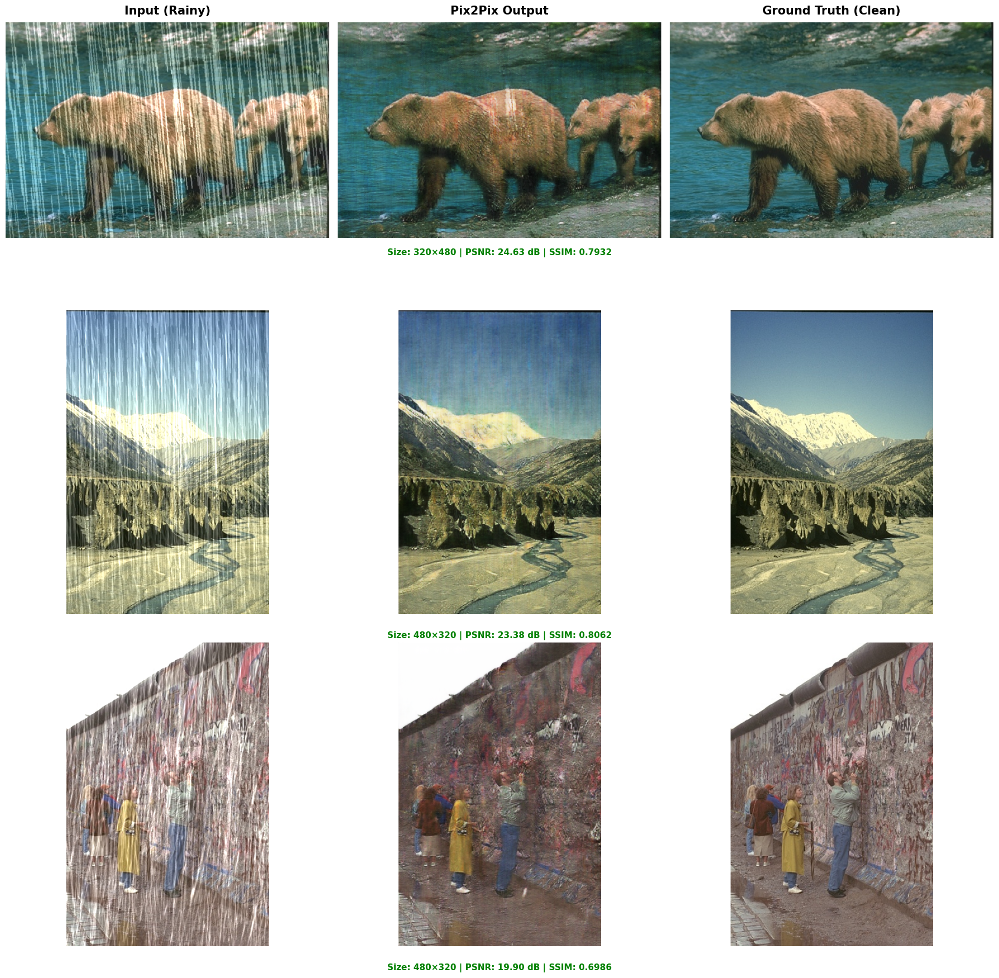

✅ Đã lưu 3 ảnh mẫu cho Rain100H
   - Raw images: evaluation_results/raw
   - Visualization: evaluation_results/Rain100H_visualization.png
✅ Hoàn thành Rain100H!


📊 ĐÁNH GIÁ DATASET: Rain100L
📁 Số lượng ảnh: 100


Evaluating: 100%|██████████| 100/100 [00:02<00:00, 38.14it/s]

Avg L1 Loss: 0.0461, Avg PSNR: 24.77, Avg SSIM: 0.8421

📸 Đang lưu ảnh mẫu cho Rain100L...


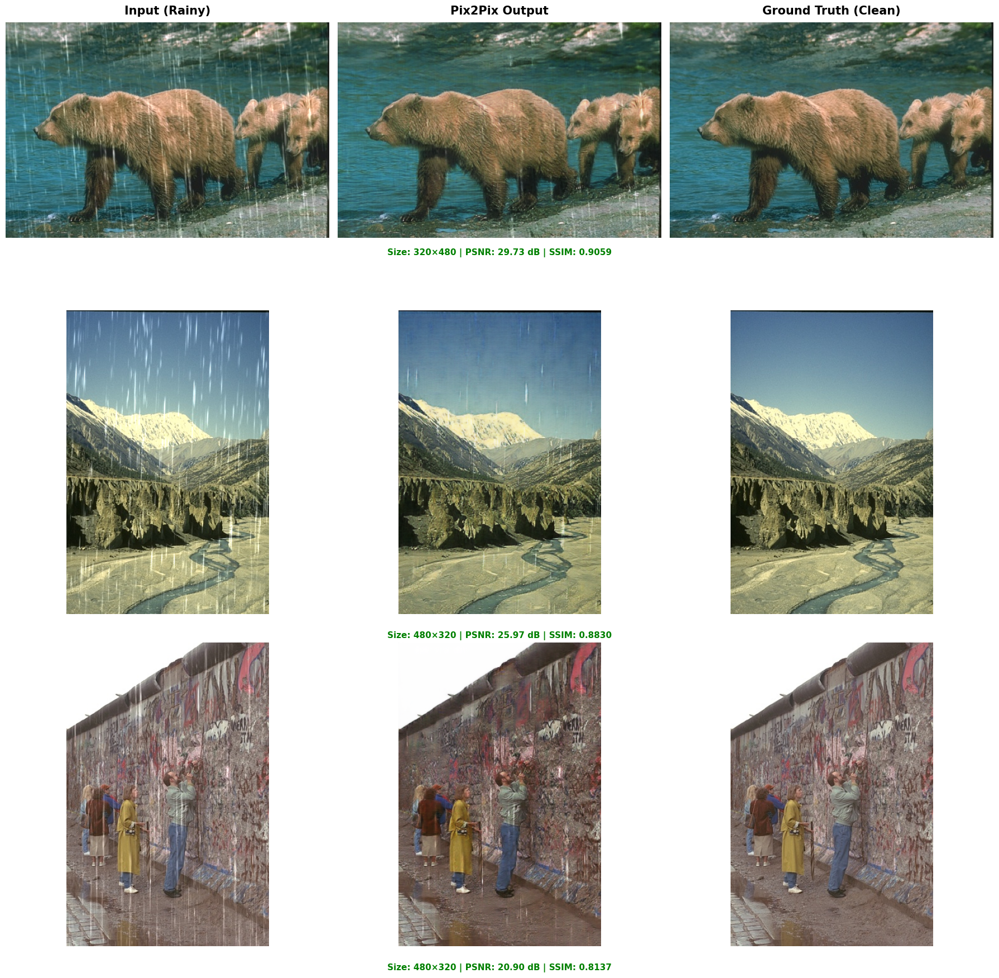

✅ Đã lưu 3 ảnh mẫu cho Rain100L
   - Raw images: evaluation_results/raw
   - Visualization: evaluation_results/Rain100L_visualization.png
✅ Hoàn thành Rain100L!


📊 ĐÁNH GIÁ DATASET: Test100
📁 Số lượng ảnh: 98


Evaluating: 100%|██████████| 98/98 [00:02<00:00, 36.93it/s]

Avg L1 Loss: 0.0684, Avg PSNR: 21.94, Avg SSIM: 0.7486

📸 Đang lưu ảnh mẫu cho Test100...


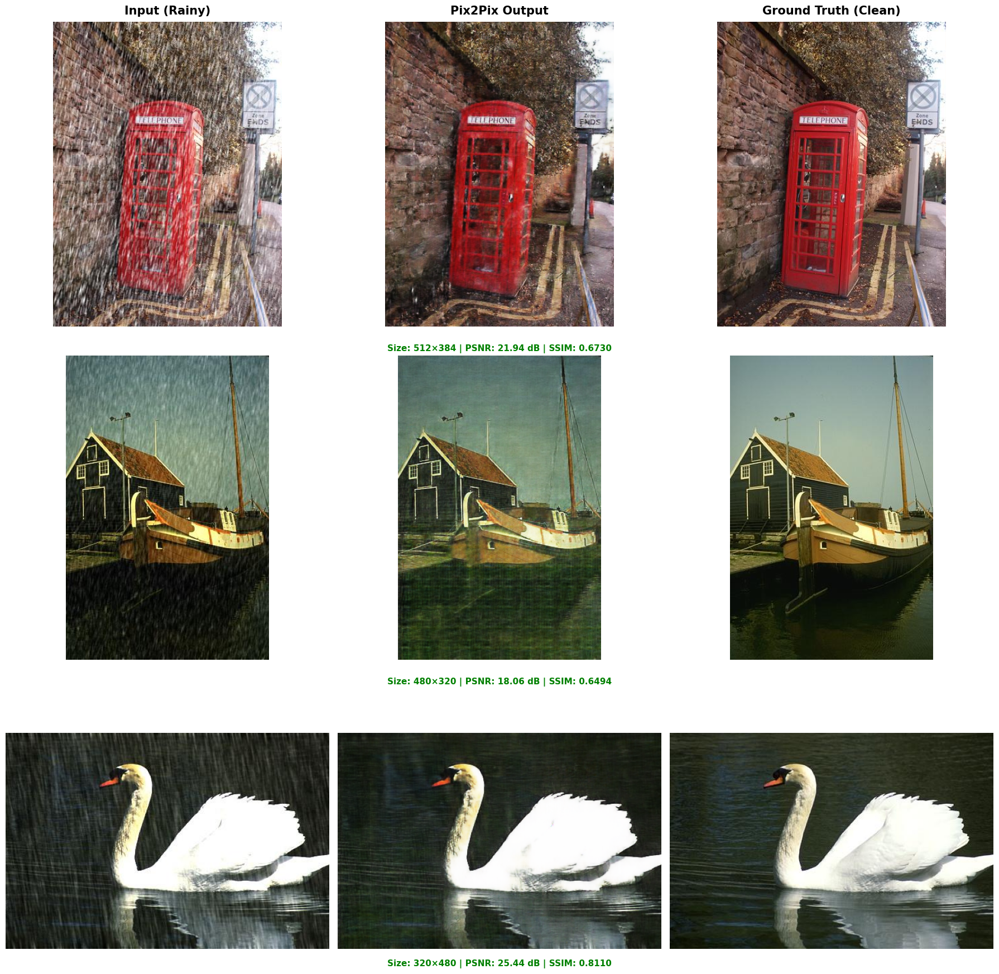

✅ Đã lưu 3 ảnh mẫu cho Test100
   - Raw images: evaluation_results/raw
   - Visualization: evaluation_results/Test100_visualization.png
✅ Hoàn thành Test100!


📊 ĐÁNH GIÁ DATASET: Test1200
📁 Số lượng ảnh: 1200


Evaluating: 100%|██████████| 1200/1200 [00:31<00:00, 37.56it/s]

Avg L1 Loss: 0.0440, Avg PSNR: 25.68, Avg SSIM: 0.7969

📸 Đang lưu ảnh mẫu cho Test1200...


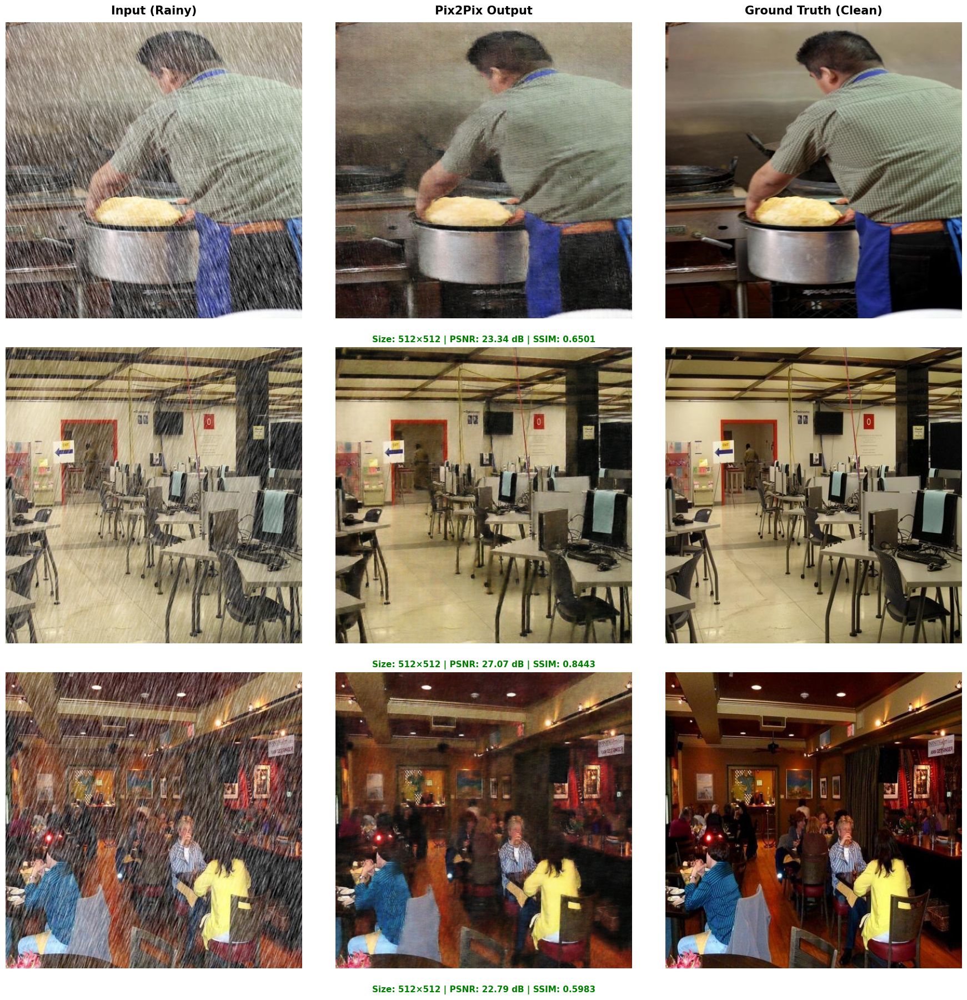

✅ Đã lưu 3 ảnh mẫu cho Test1200
   - Raw images: evaluation_results/raw
   - Visualization: evaluation_results/Test1200_visualization.png
✅ Hoàn thành Test1200!


📊 ĐÁNH GIÁ DATASET: Test2800
📁 Số lượng ảnh: 2800


Evaluating: 100%|██████████| 2800/2800 [01:18<00:00, 35.47it/s]

Avg L1 Loss: 0.0480, Avg PSNR: 24.63, Avg SSIM: 0.8132

📸 Đang lưu ảnh mẫu cho Test2800...


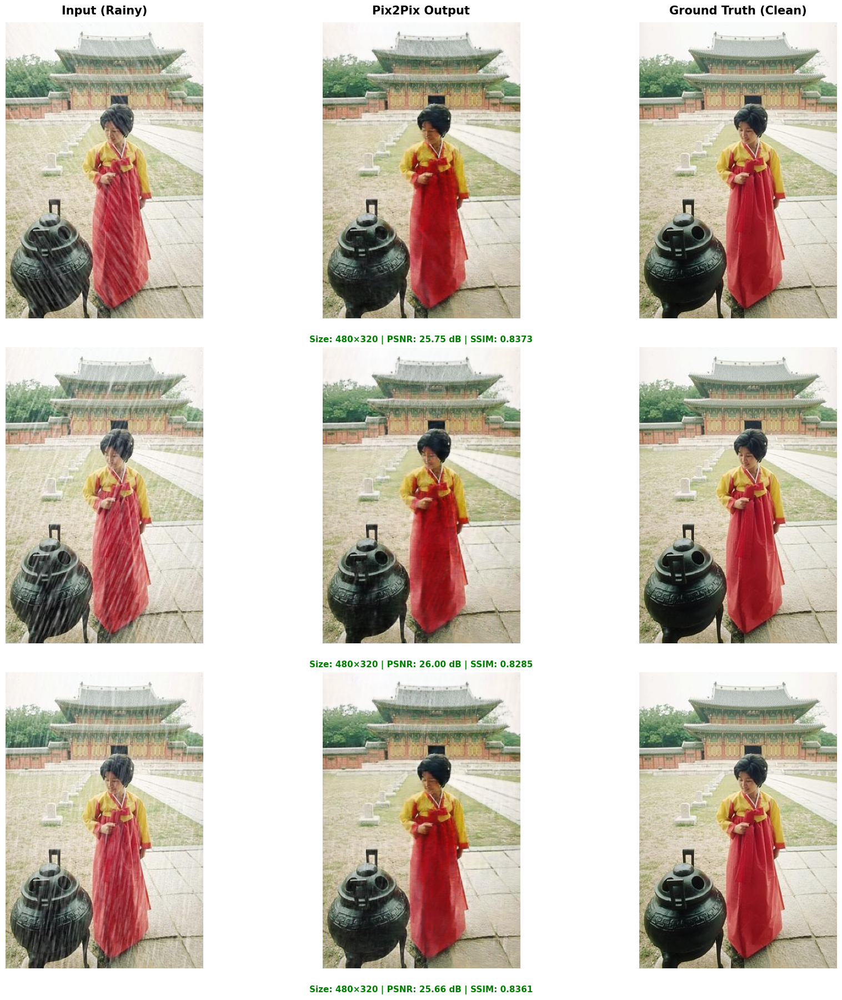

✅ Đã lưu 3 ảnh mẫu cho Test2800
   - Raw images: evaluation_results/raw
   - Visualization: evaluation_results/Test2800_visualization.png
✅ Hoàn thành Test2800!



In [ ]:
import torch
import torch.nn.functional as F
from torch.utils.data import DataLoader
from tqdm import tqdm
import os

test_root_path = '/kaggle/input/rain13kdataset/test/test'
device = "cuda" if torch.cuda.is_available() else "cpu"

# Danh sách test datasets
test_datasets_names = ['Rain100H', 'Rain100L', 'Test100', 'Test1200', 'Test2800']

# Load model
best_model_path = '/kaggle/input/deraining-pix2pix/result/bs8_alpha300/generator_best.pth'
eval_save_dir = "evaluation_results"
os.makedirs(eval_save_dir, exist_ok=True)

print(f"Đang load model từ: {best_model_path}")
if not os.path.exists(best_model_path):
    raise FileNotFoundError(f"Không tìm thấy file model: {best_model_path}")

generator = UnetGenerator().to(device)
checkpoint = torch.load(best_model_path, map_location=device)
generator.load_state_dict(checkpoint)
generator.eval()

results_data = []

print("\n" + "="*70)
print("🚀 BẮT ĐẦU ĐÁNH GIÁ TRÊN TOÀN BỘ TẬP TEST")
print("="*70)

for name in test_datasets_names:
    print(f"\n{'='*70}")
    print(f"📊 ĐÁNH GIÁ DATASET: {name}")
    print(f"{'='*70}")
    
    full_path = os.path.join(test_root_path, name)
    input_dir = os.path.join(full_path, 'input')
    target_dir = os.path.join(full_path, 'target')
    
    if not os.path.exists(input_dir):
        print(f"⚠️ Bỏ qua {name}: Không tìm thấy thư mục input.")
        continue
    
    # Lấy danh sách file
    input_files = sorted([os.path.join(input_dir, f) for f in os.listdir(input_dir) 
                         if f.endswith(('.png', '.jpg', '.jpeg'))])
    target_files = sorted([os.path.join(target_dir, f) for f in os.listdir(target_dir) 
                          if f.endswith(('.png', '.jpg', '.jpeg'))])
    
    test_ds = RainDataset(input_files, target_files)
    test_loader = DataLoader(test_ds, batch_size=1, shuffle=False, num_workers=2)
    
    print(f"📁 Số lượng ảnh: {len(test_ds)}")
    
    avg_l1, avg_psnr, avg_ssim = evaluate_model_original_size(generator, test_loader, device)
    
    # Lưu kết quả
    results_data.append({
        "Dataset": name,
        "Images": len(test_ds),
        "PSNR (dB)": avg_psnr,
        "SSIM": avg_ssim,
        "L1 Loss": avg_l1
    })
    
    # Lưu ảnh mẫu
    print(f"\n📸 Đang lưu ảnh mẫu cho {name}...")
    save_sample_images(name, generator, test_loader, eval_save_dir, device, max_samples=3)
    
    print(f"✅ Hoàn thành {name}!\n")

In [33]:
print("BẢNG TỔNG HỢP KẾT QUẢ ĐÁNH GIÁ")
import pandas as pd
from tabulate import tabulate

df_results = pd.DataFrame(results_data)
df_results = df_results[["Dataset", "Images", "PSNR (dB)", "SSIM", "L1 Loss"]]

print(tabulate(df_results, headers='keys', tablefmt='grid', 
               floatfmt=".4f", showindex=False))

# Tính trung bình weighted
total_images = df_results["Images"].sum()
weighted_psnr = (df_results["PSNR (dB)"] * df_results["Images"]).sum() / total_images
weighted_ssim = (df_results["SSIM"] * df_results["Images"]).sum() / total_images
weighted_l1 = (df_results["L1 Loss"] * df_results["Images"]).sum() / total_images

print("\nTRUNG BÌNH TỔNG THỂ (Weighted Average)")
print(f"  • Total Images    : {total_images}")
print(f"  • Average PSNR    : {weighted_psnr:.4f} dB")
print(f"  • Average SSIM    : {weighted_ssim:.4f}")
print(f"  • Average L1 Loss : {weighted_l1:.4f}")
# Lưu kết quả
csv_path = os.path.join(eval_save_dir, "final_benchmark_results.csv")
df_results.to_csv(csv_path, index=False, float_format='%.4f')

BẢNG TỔNG HỢP KẾT QUẢ ĐÁNH GIÁ
+-----------+----------+-------------+--------+-----------+
| Dataset   |   Images |   PSNR (dB) |   SSIM |   L1 Loss |
+===========+==========+=============+========+===========+
| Rain100H  |      100 |     21.4558 | 0.6734 |    0.0664 |
+-----------+----------+-------------+--------+-----------+
| Rain100L  |      100 |     24.7700 | 0.8421 |    0.0461 |
+-----------+----------+-------------+--------+-----------+
| Test100   |       98 |     21.9356 | 0.7486 |    0.0684 |
+-----------+----------+-------------+--------+-----------+
| Test1200  |     1200 |     25.6787 | 0.7969 |    0.0440 |
+-----------+----------+-------------+--------+-----------+
| Test2800  |     2800 |     24.6329 | 0.8132 |    0.0480 |
+-----------+----------+-------------+--------+-----------+

TRUNG BÌNH TỔNG THỂ (Weighted Average)
  • Total Images    : 4298
  • Average PSNR    : 24.7927 dB
  • Average SSIM    : 0.8046
  • Average L1 Loss : 0.0477
